In [147]:
import torch
import torch.nn as nn
from torch.utils.data import DataLoader, ConcatDataset
import torch.nn.functional as F
from torch.utils import data
from torch.utils.data.dataloader import default_collate
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
from torch.autograd import Variable
from einops import rearrange
import os
import pickle 

import argparse
import os
from tqdm import tqdm
import torch
import numpy as np
from numpy import linalg
import matplotlib.pyplot as plt
import cv2
from sklearn.metrics import auc
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import average_precision_score
from collections import defaultdict
from PIL import Image
import math
import pickle
import sys

from models.unet import UNet
from data.OASIS_dataset import OASISDataset

from data.taskonomy_replica_gso_dataset import TaskonomyReplicaGsoDataset

In [148]:
print(torch.__version__)

1.8.0


In [149]:
# OASIS pretrained
# pretrained_weights_path = '/scratch/ainaz/omnidata2/experiments/semseg/checkpoints/omnidata/3mevrwvo/epoch=51.ckpt'

# taskonomy tiny + replica
# pretrained_weights_path = '/scratch/ainaz/omnidata2/experiments/semseg/checkpoints/omnidata/2vts59o9/epoch=52.ckpt'

# taskonomy tiny + replica + hypersim
# pretrained_weights_path = '/scratch/ainaz/omnidata2/experiments/semseg/checkpoints/omnidata/1w8z04sn/epoch=52.ckpt'

# taskonomy tiny + replica + hypersim + GSO
# pretrained_weights_path = '/scratch/ainaz/omnidata2/experiments/semseg/checkpoints/omnidata/4sk98iky/epoch=51.ckpt'

# taskonomy medium
# pretrained_weights_path = '/scratch/ainaz/omnidata2/experiments/multitask/checkpoints/omnidata/1ypt36cz/epoch=31.ckpt'


In [150]:
# settings
tasks = ['rgb', 'normal', 'mask_valid']
taskonomy_variant = 'tiny'
batch_size = 16
image_size = 256
normalize_rgb = True
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# UNet

In [151]:
pretrained_weights_path = '/scratch/ainaz/XTConsistency/models/rgb2normal_baseline.pth'
unet = UNet(in_channels=3, out_channels=3)

checkpoint = torch.load(pretrained_weights_path, map_location='cuda:0')
if 'state_dict' in checkpoint:
    state_dict = {}
    for k, v in checkpoint['state_dict'].items():
        state_dict[k.replace('model.', '')] = v
else:
      state_dict = checkpoint
unet.load_state_dict(state_dict)
unet.to(device)
unet.eval()

UNet(
  (down1): UNet_down_block(
    (conv1): Conv2d(3, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (bn1): GroupNorm(8, 16, eps=1e-05, affine=True)
    (conv2): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (bn2): GroupNorm(8, 16, eps=1e-05, affine=True)
    (conv3): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (bn3): GroupNorm(8, 16, eps=1e-05, affine=True)
    (max_pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (relu): ReLU()
  )
  (down_blocks): ModuleList(
    (0): UNet_down_block(
      (conv1): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn1): GroupNorm(8, 32, eps=1e-05, affine=True)
      (conv2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn2): GroupNorm(8, 32, eps=1e-05, affine=True)
      (conv3): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn3): GroupNorm(8, 32, eps=1e-05, affine=True)


In [152]:
pretrained_weights_path = '/scratch/ainaz/omnidata2/exps/checkpoints/omnidata/3ef56j3n/epoch=157.ckpt'


unet2 = UNet(in_channels=3, out_channels=3)

checkpoint = torch.load(pretrained_weights_path, map_location='cuda:0')
if 'state_dict' in checkpoint:
    state_dict = {}
    for k, v in checkpoint['state_dict'].items():
        state_dict[k.replace('model.', '')] = v
else:
      state_dict = checkpoint
unet2.load_state_dict(state_dict)
unet2.to(device)
unet2.eval()

UNet(
  (down1): UNet_down_block(
    (conv1): Conv2d(3, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (bn1): GroupNorm(8, 16, eps=1e-05, affine=True)
    (conv2): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (bn2): GroupNorm(8, 16, eps=1e-05, affine=True)
    (conv3): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (bn3): GroupNorm(8, 16, eps=1e-05, affine=True)
    (max_pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (relu): ReLU()
  )
  (down_blocks): ModuleList(
    (0): UNet_down_block(
      (conv1): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn1): GroupNorm(8, 32, eps=1e-05, affine=True)
      (conv2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn2): GroupNorm(8, 32, eps=1e-05, affine=True)
      (conv3): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn3): GroupNorm(8, 32, eps=1e-05, affine=True)


# Geonet

# OASIS Model

In [153]:
class Inception(nn.Module):
    def __init__(self, input_size, config):
        self.config = config
        super(Inception,self).__init__()
        self.convs = nn.ModuleList()

        # Base 1*1 conv layer
        self.convs.append(nn.Sequential(
          nn.Conv2d(input_size, config[0][0],1,1),
          nn.BatchNorm2d(config[0][0],affine=False),
          nn.ReLU(True),
        ))

        # Additional layers
        for i in range(1, len(config)):
            filt = config[i][0]
            pad = int((filt-1)/2)
            out_a = config[i][1]
            out_b = config[i][2]
            conv = nn.Sequential(
                nn.Conv2d(input_size, out_a,1,1),
                nn.BatchNorm2d(out_a,affine=False),
                nn.ReLU(True),
                nn.Conv2d(out_a, out_b, filt,padding=pad),
                nn.BatchNorm2d(out_b,affine=False),
                nn.ReLU(True)
            )
            self.convs.append(conv)

    def __repr__(self):
        return "inception"+str(self.config)

    def forward(self, x):
        ret = []
        for conv in (self.convs):
            ret.append(conv(x))
            # print(torch.cat(ret,dim=1))
        return torch.cat(ret,dim=1)
    
class Interpolate(nn.Module):
    def __init__(self, scale_factor):
        super(Interpolate, self).__init__()
        self.scale_factor = scale_factor
        self.mode = 'nearest'
      
    def forward(self, x):
        x = nn.functional.interpolate(x, scale_factor=self.scale_factor, mode=self.mode)
        return x

class Channels1(nn.Module):
    def __init__(self):
        super(Channels1, self).__init__()
        self.list = nn.ModuleList()
        self.list.append(
          nn.Sequential(
            Inception(256,[[64],[3,32,64],[5,32,64],[7,32,64]]),
            Inception(256,[[64],[3,32,64],[5,32,64],[7,32,64]])
          )
        ) #EE
        self.list.append(
          nn.Sequential(
            nn.MaxPool2d(kernel_size=2,stride=2),
            Inception(256,[[64],[3,32,64],[5,32,64],[7,32,64]]),
            Inception(256,[[64],[3,32,64],[5,32,64],[7,32,64]]),
            Inception(256,[[64],[3,32,64],[5,32,64],[7,32,64]]), 
            Interpolate(scale_factor=2)
          )
        ) #EEE

    def forward(self,x):
        return self.list[0](x)+self.list[1](x)

class Channels2(nn.Module):
    def __init__(self):
        super(Channels2, self).__init__()
        self.list = nn.ModuleList()
        self.list.append(
          nn.Sequential(
            Inception(256, [[64], [3,32,64], [5,32,64], [7,32,64]]), 
            Inception(256, [[64], [3,64,64], [7,64,64], [11,64,64]])
          )
        )#EF
        self.list.append( 
          nn.Sequential(
            nn.AvgPool2d(kernel_size=2, stride=2),
            Inception(256, [[64], [3,32,64], [5,32,64], [7,32,64]]), 
            Inception(256, [[64], [3,32,64], [5,32,64], [7,32,64]]), 
            Channels1(),
            Inception(256, [[64], [3,32,64], [5,32,64], [7,32,64]]), 
            Inception(256, [[64], [3,64,64], [7,64,64], [11,64,64]]),
            Interpolate(scale_factor=2)
          )
        )#EE1EF

    def forward(self,x):
        return self.list[0](x)+self.list[1](x)

class Channels3(nn.Module):
    def __init__(self):
        super(Channels3, self).__init__()
        self.list = nn.ModuleList()
        self.list.append(
          nn.Sequential(
            nn.AvgPool2d(kernel_size=2, stride=2),
            Inception(128, [[32], [3,32,32], [5,32,32], [7,32,32]]),
            Inception(128, [[64], [3,32,64], [5,32,64], [7,32,64]]),
            Channels2(),
            Inception(256, [[64], [3,32,64], [5,32,64], [7,32,64]]), 
            Inception(256, [[32], [3,32,32], [5,32,32], [7,32,32]]), 
            Interpolate(scale_factor=2)
            )
          )#BD2EG
        self.list.append(
          nn.Sequential(
            Inception(128, [[32], [3,32,32], [5,32,32], [7,32,32]]), 
            Inception(128, [[32], [3,64,32], [7,64,32], [11,64,32]])
            )
          )#BC

    def forward(self,x):
        return self.list[0](x)+self.list[1](x)

class Channels4(nn.Module):
    def __init__(self):
        super(Channels4, self).__init__()
        self.list = nn.ModuleList()
        self.list.append(
          nn.Sequential(
            nn.AvgPool2d(kernel_size=2, stride=2),
            Inception(128, [[32], [3,32,32], [5,32,32], [7,32,32]]),
            Inception(128, [[32], [3,32,32], [5,32,32], [7,32,32]]),
            Channels3(),
            Inception(128, [[32], [3,64,32], [5,64,32], [7,64,32]]),
            Inception(128, [[16], [3,32,16], [7,32,16], [11,32,16]]),
            Interpolate(scale_factor=2)
            )
          )#BB3BA
        self.list.append(
          nn.Sequential(
            Inception(128, [[16], [3,64,16], [7,64,16], [11,64,16]])
            )
          )#A

    def forward(self,x):
        return self.list[0](x)+self.list[1](x)


class NIPSDepthNetwork(nn.Module):
    def __init__(self):
        super(NIPSDepthNetwork, self).__init__()

        print("===================================================")
        print("Using NIPSDepthNetwork")
        print("===================================================")

        self.seq = nn.Sequential(
          nn.Conv2d(3,128,7,padding=3,stride=1), 
          nn.BatchNorm2d(128), 
          nn.ReLU(True),
          Channels4(),
          nn.Conv2d(64,1,3,padding=1)
          )

    def forward(self,x):
        # print(x.data.size())
        return self.seq(x)

    def prediction_from_output(self, outputs):
        return outputs

class NIPSSurfaceNetwork(nn.Module):
    def __init__(self):
        super(NIPSSurfaceNetwork, self).__init__()

        print("===================================================")
        print("Using NIPSSurfaceNetwork")
        print("===================================================")

        self.seq = nn.Sequential(
          nn.Conv2d(3,128,7,padding=3),
          nn.BatchNorm2d(128),
          nn.ReLU(True),
          Channels4(),
          nn.Conv2d(64,3,3,padding=1)
        )
  
    def forward(self,x):
        return self.seq(x)

    def prediction_from_output(self, outputs):
        return outputs

def get_model():
    return Model()

In [154]:
model = NIPSSurfaceNetwork()
model_path = '/scratch/ainaz/OASIS/experiments/normal_estimation/exp/nom_OASIS_0.0001'
model_file = os.path.join(model_path, 'models/best_model_iter_249000.bin')
args_file = os.path.join(model_path, 'args.pkl')


Using NIPSSurfaceNetwork


In [155]:
with open(args_file, 'rb') as f:
    args = pickle.load(f)
args

{'train_file': '/n/fs/vl/datasets/SNOW/SNOW_Toolkit/SNOW_train_release.csv',
 'valid_file': '/n/fs/vl/datasets/SNOW/SNOW_Toolkit/SNOW_val_release.csv',
 'dataset_name': 'SNOWDataset',
 'model_name': 'NIPSSurface',
 'loss_name': 'CosineAngularLoss',
 'in_coord_sys': 'SNOW',
 'out_coord_sys': 'SNOW',
 'num_iters': 500000,
 'num_epoches': 100000,
 'batch_size': 12,
 'model_save_interval': 5000,
 'model_eval_interval': 3000,
 'learning_rate': 0.0001,
 'n_GPUs': 1,
 'num_loader_workers': 2,
 'pretrained_model': None,
 'pretrained_optimizer': None,
 'data_aug': False}

In [156]:
front_facing = False

def is_data_parallel(state_dict):
    for key in state_dict:
        if 'module' in key:
            return True
    return False

if not front_facing:
    state_dict = torch.load(model_file)
    print(state_dict)
    is_data_parallel = is_data_parallel(state_dict)
    print('Using DataParallel: {}'.format(is_data_parallel))
    if is_data_parallel:
        model = torch.nn.DataParallel(model)
        model.load_state_dict(state_dict)  
        model = model.module
    else:
        model.load_state_dict(state_dict)
        
model.to(device)

OrderedDict([('seq.0.weight', tensor([[[[-8.3384e-02, -5.0405e-02, -9.8724e-02,  ..., -2.2497e-02,
           -2.6288e-02,  5.6562e-02],
          [-1.0394e-02, -5.1093e-02,  8.4431e-02,  ...,  3.3455e-02,
            9.3774e-02,  1.5937e-02],
          [ 6.7897e-02,  8.4442e-02,  2.1892e-02,  ...,  5.1633e-02,
            6.6771e-02, -7.4329e-02],
          ...,
          [ 1.2656e-02, -1.7239e-02, -1.1473e-02,  ...,  4.5704e-02,
           -3.0827e-02, -1.0941e-02],
          [ 2.7996e-02, -6.2315e-02,  8.4847e-02,  ...,  5.2509e-02,
            6.3682e-04,  1.8251e-02],
          [ 5.1310e-02,  7.1501e-03,  1.4562e-02,  ...,  1.1598e-01,
            9.8626e-02,  8.4319e-02]],

         [[ 3.9235e-02, -5.1014e-02, -4.8750e-02,  ...,  6.7743e-02,
            3.9056e-03, -8.4470e-03],
          [-8.7391e-02, -8.3476e-02,  5.6391e-02,  ..., -3.9950e-02,
            6.0996e-02,  7.4807e-02],
          [ 3.1634e-03,  8.4651e-03,  3.4630e-02,  ...,  8.1809e-02,
            1.7961e-03, -6.5

NIPSSurfaceNetwork(
  (seq): Sequential(
    (0): Conv2d(3, 128, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): Channels4(
      (list): ModuleList(
        (0): Sequential(
          (0): AvgPool2d(kernel_size=2, stride=2, padding=0)
          (1): inception[[32], [3, 32, 32], [5, 32, 32], [7, 32, 32]]
          (2): inception[[32], [3, 32, 32], [5, 32, 32], [7, 32, 32]]
          (3): Channels3(
            (list): ModuleList(
              (0): Sequential(
                (0): AvgPool2d(kernel_size=2, stride=2, padding=0)
                (1): inception[[32], [3, 32, 32], [5, 32, 32], [7, 32, 32]]
                (2): inception[[64], [3, 32, 64], [5, 32, 64], [7, 32, 64]]
                (3): Channels2(
                  (list): ModuleList(
                    (0): Sequential(
                      (0): inception[[64], [3, 32, 64], [5, 32, 64], [7, 32, 64

# OASIS Data

In [157]:
class OASISNormalDataset(data.Dataset):
    def __init__(self, csv_filename, data_aug=False, img_size=256):
        super(OASISNormalDataset, self).__init__()
        print("=====================================================")
        print("Using OASISNormalDataset...")
        print("csv file name: %s" % csv_filename)

        img_names = []
        normal_names = []

        with open(csv_filename) as infile:
            next(infile) # skip header
            for line in infile:
                # Filenames are absolute directories
                img_name,_,_,normal_name,_,_,_,_,_,_,_,_,_,_ = line.split(',')
                if len(normal_name) == 0:
                    continue
                img_names.append(os.path.join('/scratch/ainaz', img_name.strip()))
                normal_names.append(os.path.join('/scratch/ainaz', normal_name.strip()))
    
        self.img_names = img_names
        self.normal_names = normal_names
        self.width = img_size #320
        self.height = img_size #240
        self.n_sample = len(self.img_names)

        self.data_aug = data_aug
        print("Network input width = %d, height = %d" % (self.width, self.height))
        print("%d samples" % (self.n_sample))
        print("Data augmentation: {}".format(self.data_aug))
        print("=====================================================")

    def __getitem__(self, index):
        color = cv2.imread(self.img_names[index]).astype(np.float32)
        normal_file = open(self.normal_names[index], 'rb')
        normal_dict = pickle.load(normal_file)


        h,w,c = color.shape
        mask = np.zeros((h,w))
        normal = np.zeros((h,w,c))

        # Stuff ROI normal into bounding box
        min_y = normal_dict['min_y']
        max_y = normal_dict['max_y']
        min_x = normal_dict['min_x']
        max_x = normal_dict['max_x']
        roi_normal = normal_dict['normal']
        try:
            normal[min_y:max_y+1, min_x:max_x+1, :] = roi_normal
            normal = normal.astype(np.float32)
        except Exception as e:
            print("Error:", self.normal_names[index])
            print(str(e))
            return 

        # Make mask
        roi_mask = np.logical_or(np.logical_or(roi_normal[:,:,0] != 0, roi_normal[:,:,1] != 0), roi_normal[:,:,2] != 0).astype(np.float32)

        mask[min_y:max_y+1, min_x:max_x+1] = roi_mask


        orig_height = color.shape[0]
        orig_width = color.shape[1]
        # Downsample training images
        color = cv2.resize(color, (self.width, self.height))
        mask = cv2.resize(mask, (self.width, self.height))
        normal = cv2.resize(normal, (self.width, self.height))

        # Data augmentation: randomly flip left to right
        if self.data_aug:
            if random.random() < 0.5:
                color = cv2.flip(color, 1)
                normal = cv2.flip(normal, 1)
                # make sure x coordinates of each vector get flipped
                normal[:,:,0] *= -1

        color = np.transpose(color, (2, 0, 1)) / 255.0  # HWC to CHW.
        normal = np.transpose(normal, (2, 0, 1))   # HWC to CHW.
        # Add one channel b/c Pytorch interpolation requires 4D tensor
        mask = mask[np.newaxis, :, :]

        return color, normal, mask, (orig_height, orig_width)

    def __len__(self):
        return self.n_sample


class OASISNormalDatasetVal(OASISNormalDataset):
    def __init__(self, csv_filename, data_aug=False):
        print("+++++++++++++++++++++++++++++++++++++++++++++++")
        print("Using OASISNormalDatasetVal...")
        print("csv file name: %s" % csv_filename)
        OASISNormalDataset.__init__(self, csv_filename, data_aug=data_aug)

    def __getitem__(self, index):
#         color = cv2.imread(self.img_names[index]).astype(np.float32)
        color = np.array(Image.open(self.img_names[index])).astype(np.float32) # my code
        normal_file = open(self.normal_names[index], 'rb')
        normal_dict = pickle.load(normal_file)

        h,w,c = color.shape
        mask = np.zeros((h,w))
        normal = np.zeros((h,w,c))

        # Stuff ROI normal into bounding box
        min_y = normal_dict['min_y']
        max_y = normal_dict['max_y']
        min_x = normal_dict['min_x']
        max_x = normal_dict['max_x']
        roi_normal = normal_dict['normal']
        try:
            normal[min_y:max_y+1, min_x:max_x+1, :] = roi_normal
            normal = normal.astype(np.float32)
        except Exception as e:
            print("Error:", self.normal_names[index])
            print(str(e))
            return 

        # Make mask
        roi_mask = np.logical_or(np.logical_or(roi_normal[:,:,0] != 0, roi_normal[:,:,1] != 0), roi_normal[:,:,2] != 0).astype(np.float32)

        mask[min_y:max_y+1, min_x:max_x+1] = roi_mask

        orig_height = color.shape[0]
        orig_width = color.shape[1]

        ############ my code
        orig_height = min(color.shape[0], color.shape[1])
        orig_width = min(color.shape[0], color.shape[1])
        center_x = (min_x + max_x) // 2
        center_y = (min_y + max_y) // 2
        h, w = orig_height, orig_width
        if h < w:
            if center_x > w // 2: 
                color = color[0:h, w-h:w]
                mask = mask[0:h, w-h:w]
                normal = normal[0:h, w-h:w]
            else: 
                color = color[0:h, 0:h]
                mask = mask[0:h, 0:h]
                normal = normal[0:h, 0:h]
        else:
            if center_y > h // 2: 
                color = color[h-w:h, 0:w]
                mask = mask[h-w:h, 0:w]
                normal = normal[h-w:h, 0:w]
            else: 
                color = color[0:w, 0:w]
                mask = mask[0:w, 0:w]
                normal = normal[0:w, 0:w]
        ####################

        # Downsample training images
        color = cv2.resize(color, (self.width, self.height))
        color = np.transpose(color, (2, 0, 1)) / 255.0  # HWC to CHW.
        normal = np.transpose(normal, (2, 0, 1))   # HWC to CHW.
        
        # Add one channel b/c Pytorch interpolation requires 4D tensor
        mask = mask[np.newaxis, :, :]

        return color, normal, mask, (orig_height, orig_width), self.img_names[index]

    def __len__(self):
        return self.n_sample

In [158]:
test_file = '/scratch/ainaz/OASIS/OASIS_trainval/OASIS_val.csv'
collate_fn = default_collate
DataSet = OASISNormalDatasetVal
dataset_name = 'OASISNormalDatasetVal'
test_dataset = DataSet(csv_filename = test_file)
test_data_loader = data.DataLoader(test_dataset, batch_size=1, num_workers=1, shuffle=False, collate_fn = collate_fn)

+++++++++++++++++++++++++++++++++++++++++++++++
Using OASISNormalDatasetVal...
csv file name: /scratch/ainaz/OASIS/OASIS_trainval/OASIS_val.csv
Using OASISNormalDataset...
csv file name: /scratch/ainaz/OASIS/OASIS_trainval/OASIS_val.csv
Network input width = 256, height = 256
10000 samples
Data augmentation: False


(3, 256, 256)


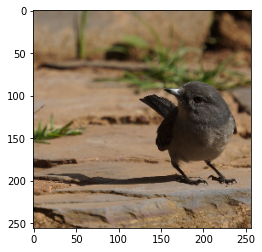

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


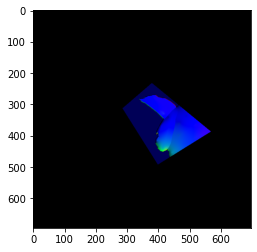

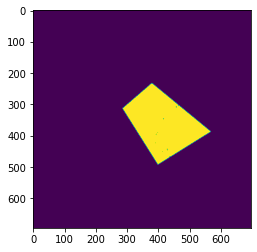

In [159]:
rgb, normal, mask, orig_size, name = test_dataset[10]
print(rgb.shape)
plt.imshow(rgb.transpose(1,2,0))
plt.show()
plt.imshow(normal.transpose(1,2,0))
plt.show()
plt.imshow(mask.transpose(1,2,0))
plt.show()

In [160]:
def vis_normal(rgb, pred, gt):

    rgb = rgb * 255.0
    gt = gt * 255.0
    
               
    print(pred.max(), pred.min())
    pred[:,:,2] *= -1
#     pred[:,:,1] *= -1
    pred -= np.min(pred)
    pred = pred * 1.0 / np.max(pred) 
    print(pred.max(), pred.min())      
    pred = pred * 255.0
    
    im = np.concatenate([rgb, gt, pred], axis=1)
    
#     if not is_color:
#         # BGR -> RGB
#         im = im[:,:,[2,1,0]]
    plt.figure(figsize=(16, 8))
    plt.imshow(np.uint8(im))
    plt.show()

In [30]:
output_var2 = output_var / torch.linalg.norm(output_var, dim=1)

1.0 -0.8930471
1.0 0.0


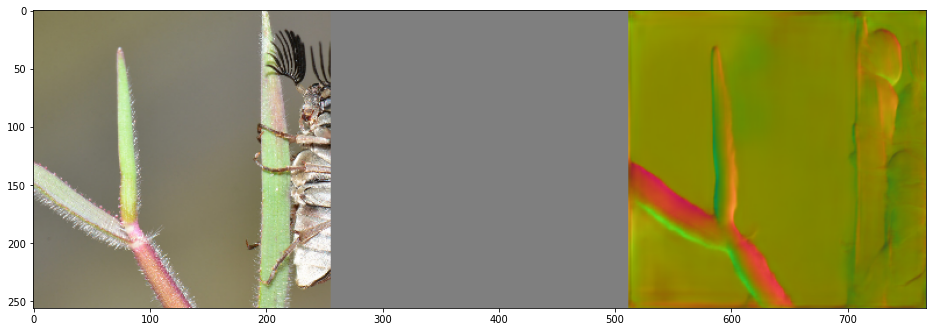

0.99999225 -0.9823253
1.0 0.0


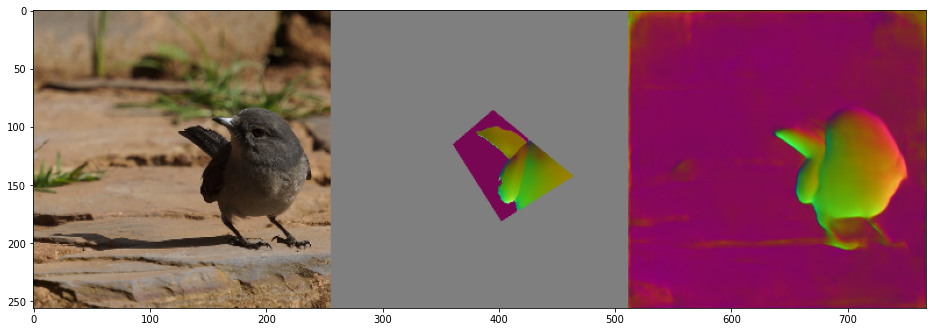

0.9999998 -0.9928304
1.0 0.0


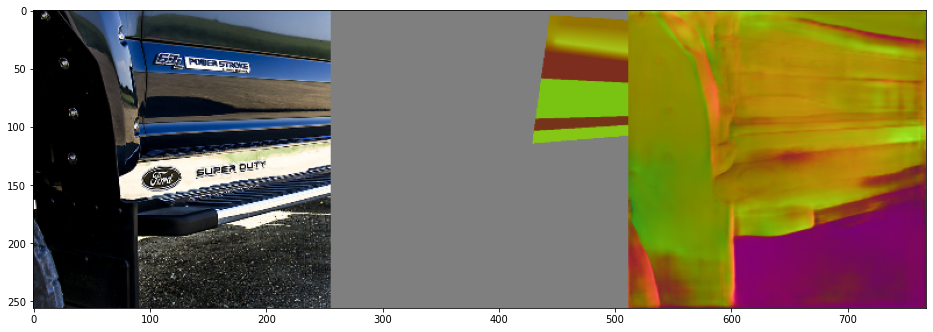

0.99999994 -0.86090505
1.0 0.0


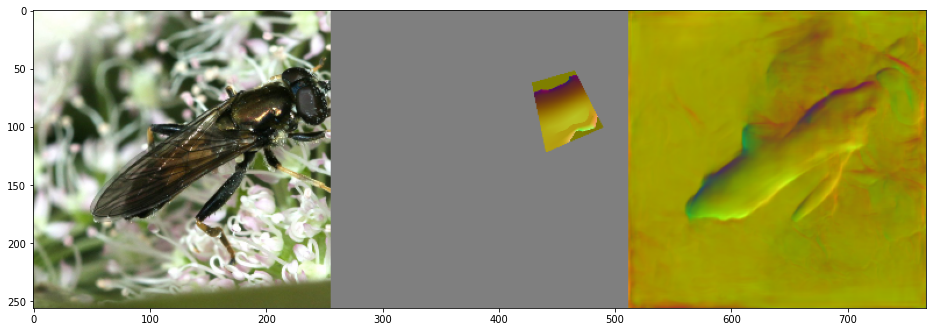

0.9999997 -0.88581574
1.0 0.0


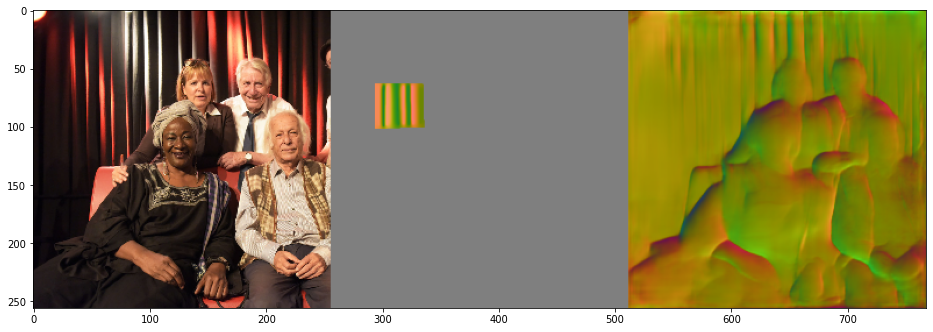

0.9999995 -0.9956354
1.0 0.0


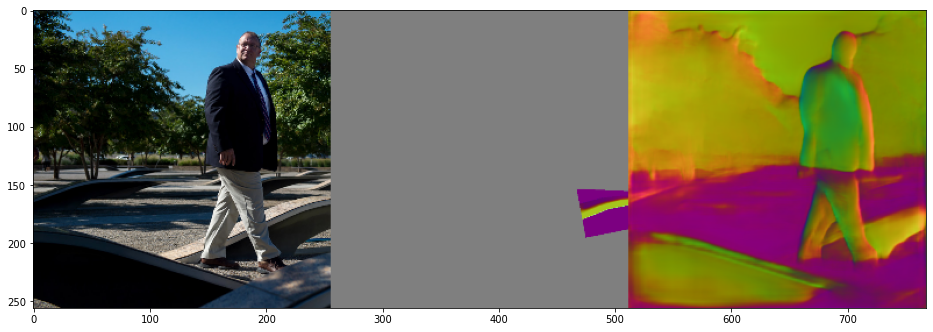

0.99999976 -0.98886675
1.0 0.0


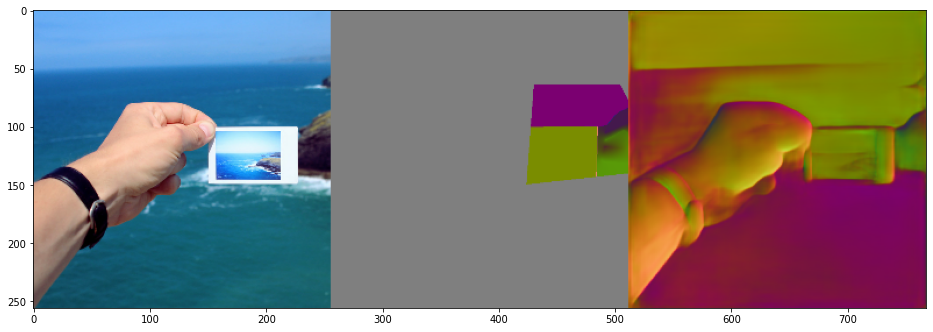

0.99999994 -0.98753357
1.0 0.0


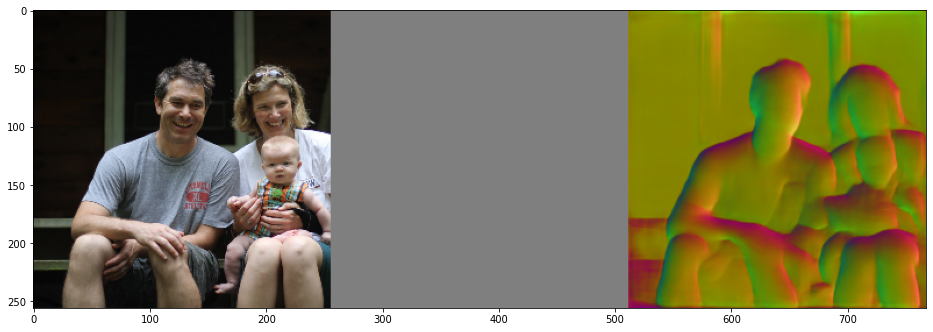

0.9999984 -0.94021386
1.0 0.0


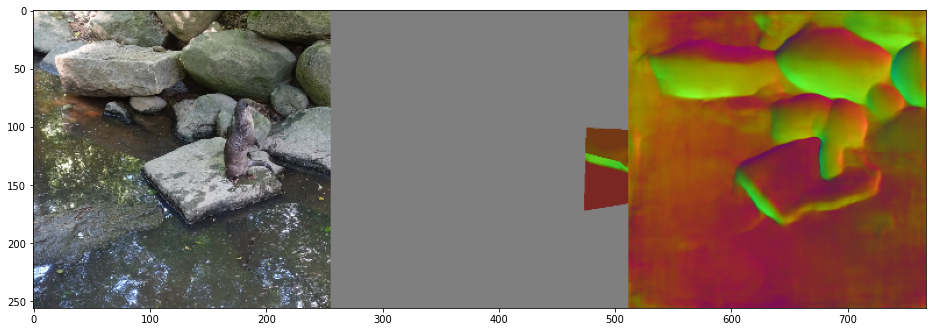

0.99999994 -0.9873432
1.0 0.0


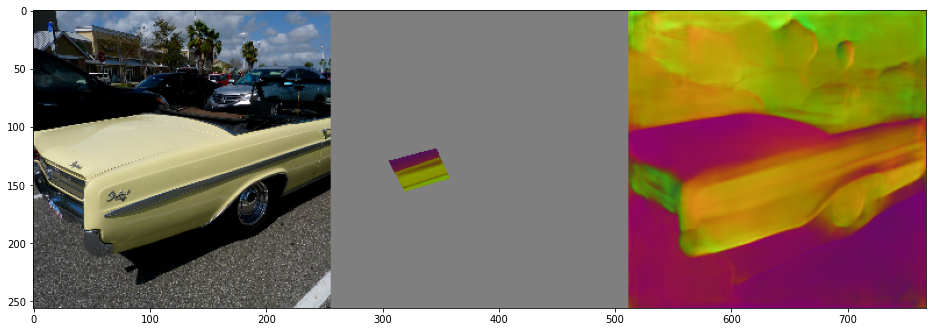

1.0 -0.85521716
1.0 0.0


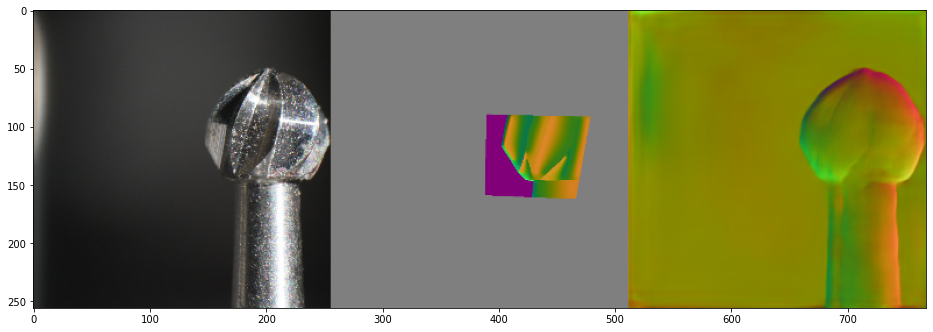

0.9999998 -0.700536
1.0 0.0


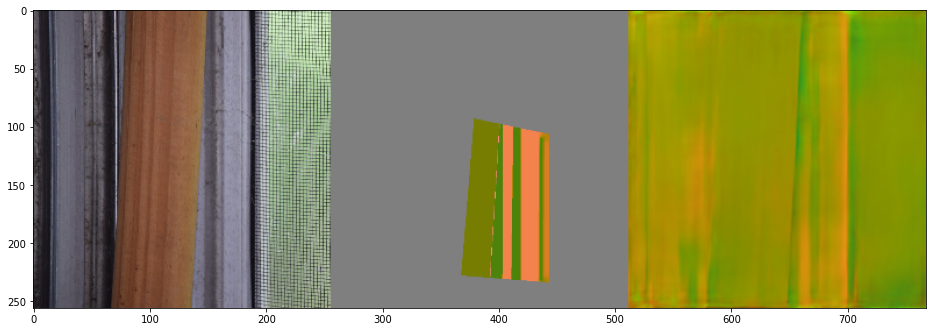

1.0 -0.9961629
1.0 0.0


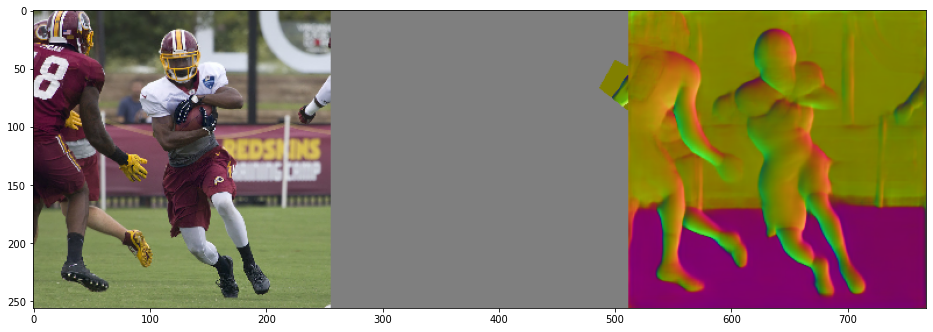

1.0 -0.99436486
1.0 0.0


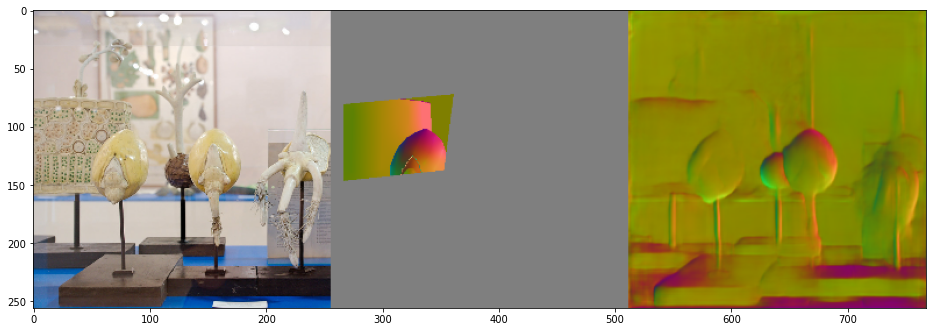

0.99999964 -0.9383861
1.0 0.0


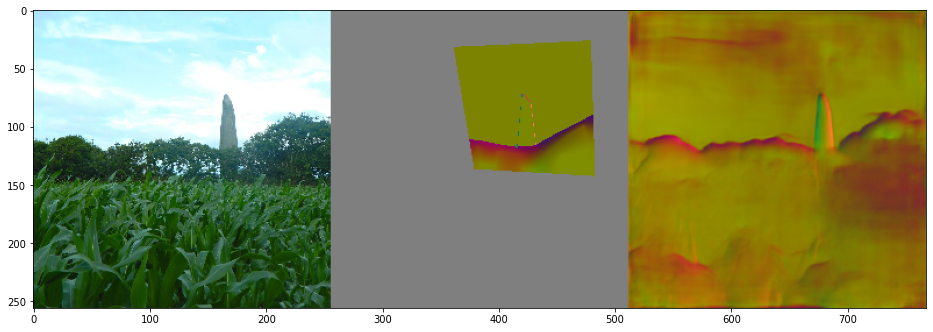

0.9999995 -0.99563915
1.0 0.0


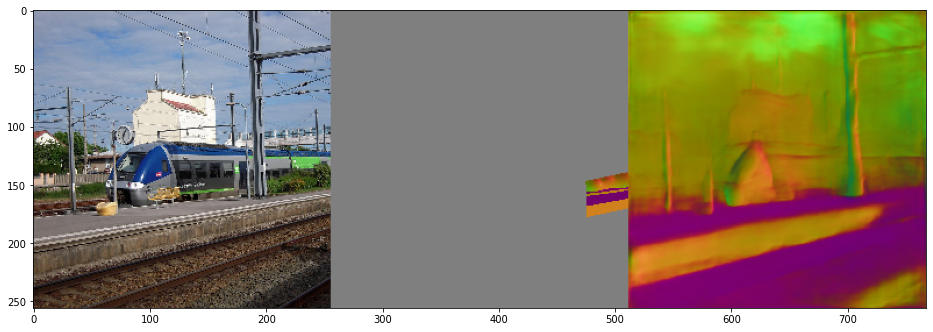

0.99999976 -0.9830919
1.0 0.0


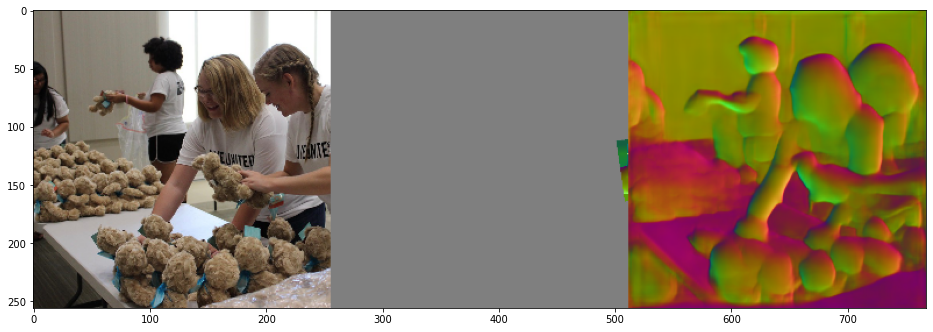

0.9999996 -0.99437845
1.0 0.0


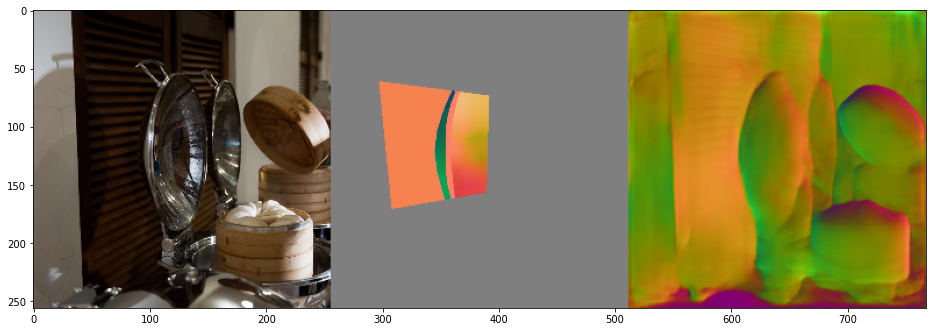

0.9999997 -0.9777777
1.0 0.0


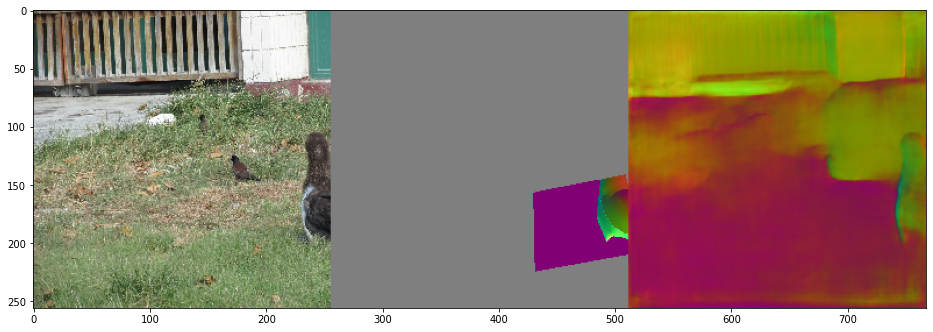

1.0 -0.86932
1.0 0.0


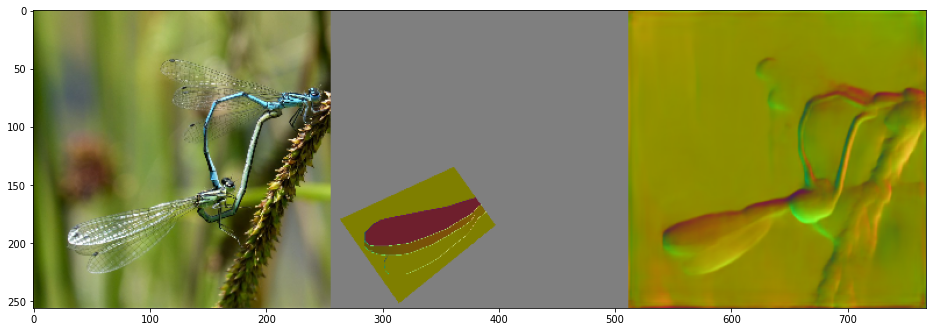

0.99999917 -0.96698594
1.0 0.0


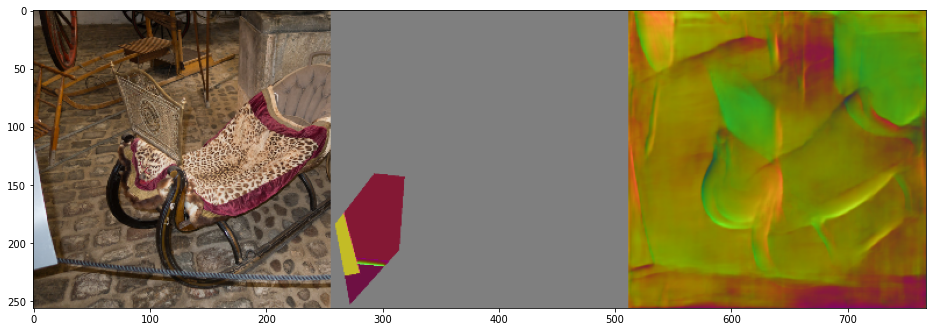

0.9999995 -0.9985736
1.0 0.0


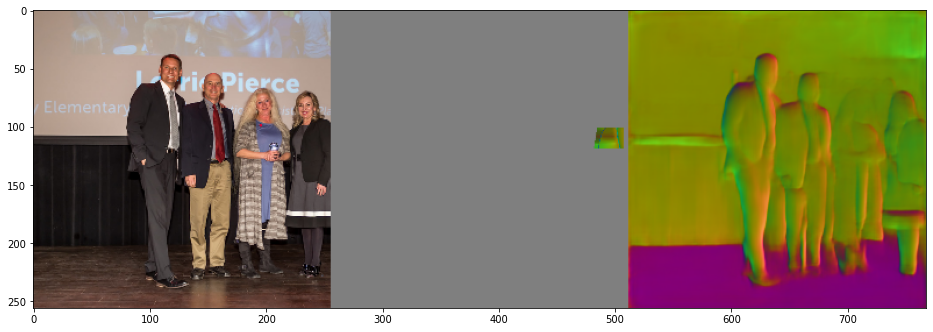

1.0 -0.98995745
1.0 0.0


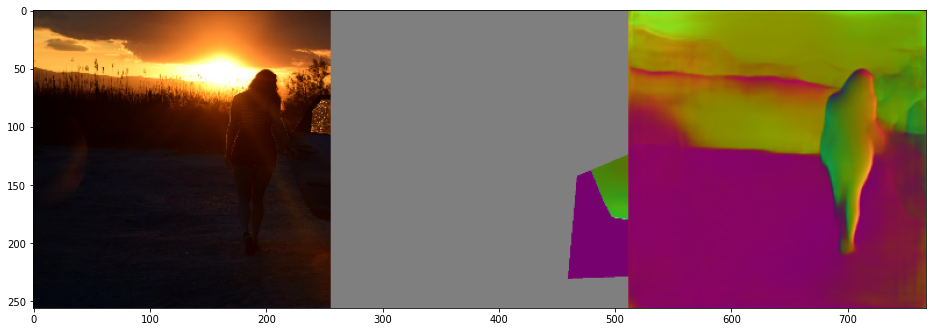

0.99999624 -0.9899164
1.0 0.0


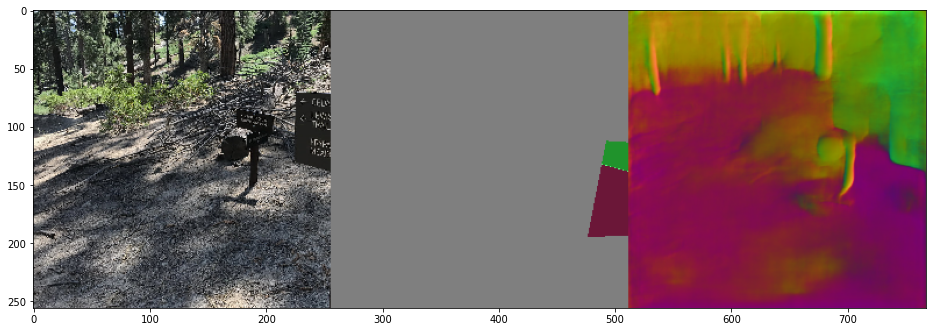

0.9999993 -0.9999105
1.0 0.0


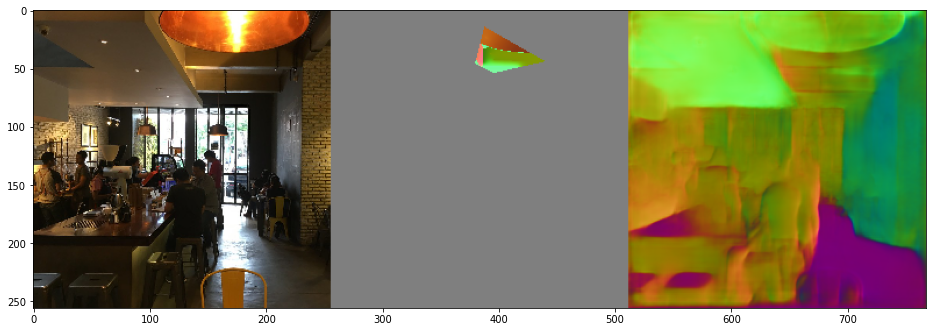

0.9999973 -0.9966632
1.0 0.0


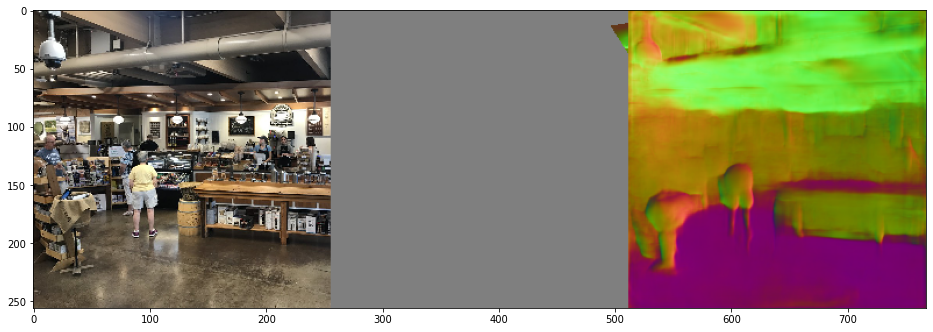

0.99999976 -0.92918366
1.0 0.0


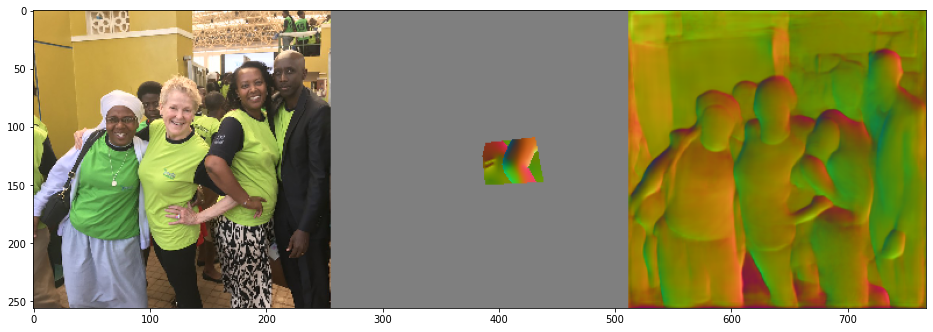

1.0 -0.9492713
1.0 0.0


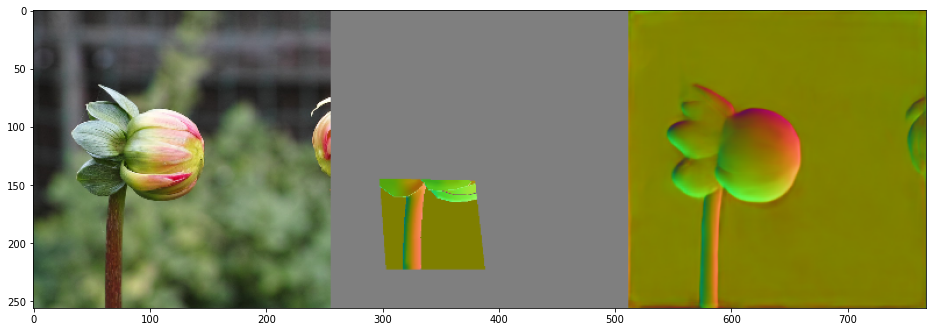

0.9999988 -0.89914924
1.0 0.0


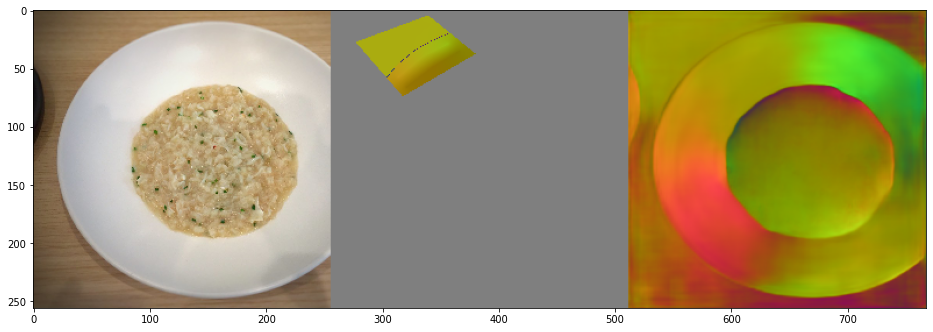

1.0 -0.9241336
1.0 0.0


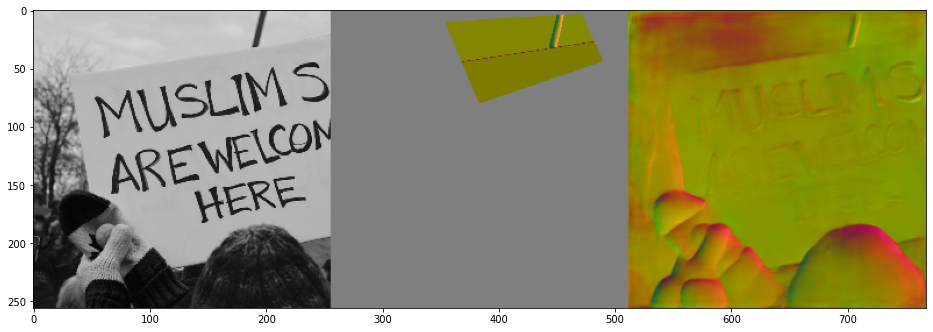

0.99999976 -0.95772743
1.0 0.0


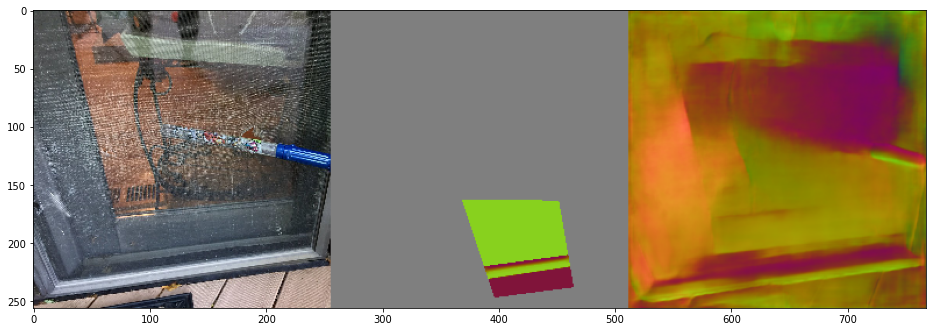

0.99999964 -0.96591955
1.0 0.0


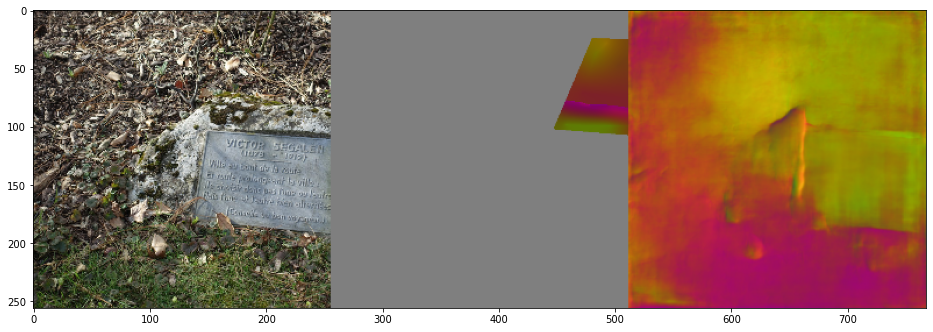

1.0 -0.99581176
1.0 0.0


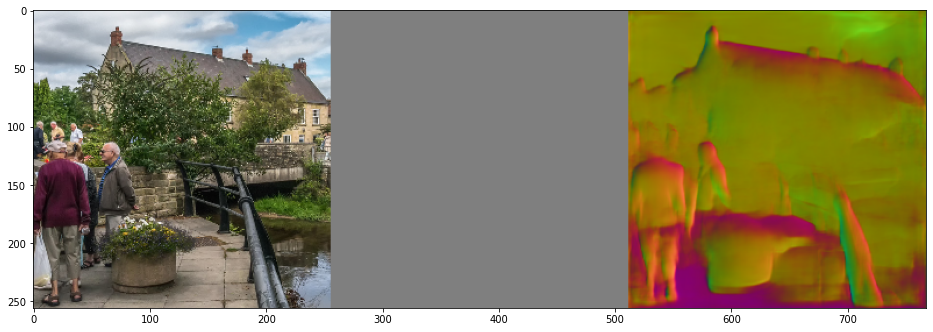

0.99999994 -0.9044295
1.0 0.0


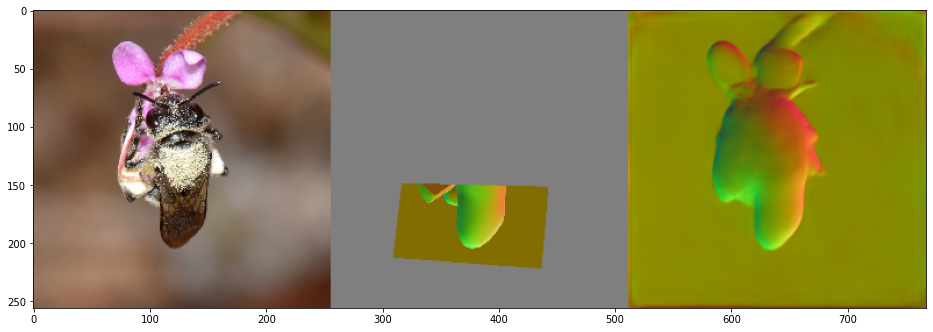

1.0 -0.90699667
1.0 0.0


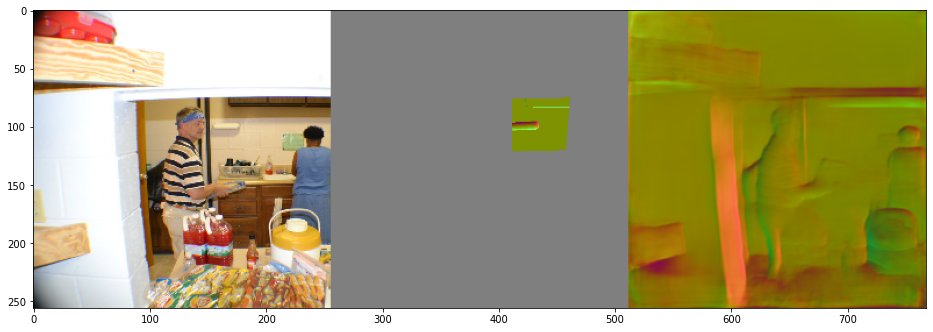

0.99999994 -0.9335015
1.0 0.0


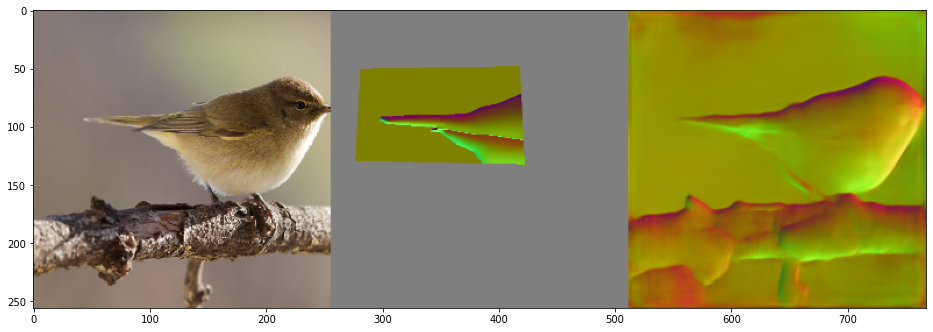

0.9999998 -0.99682194
1.0 0.0


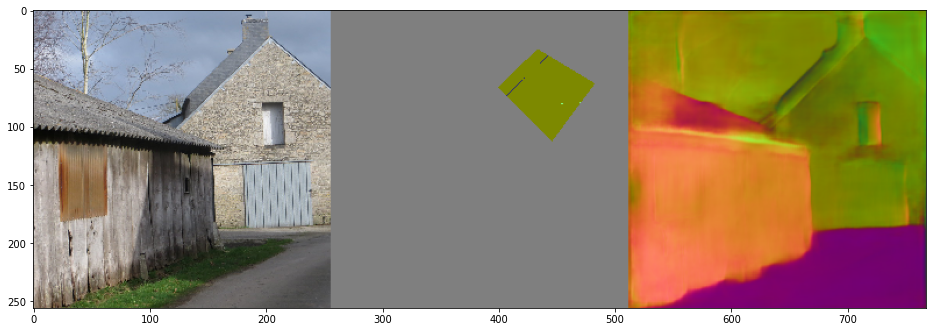

0.9999991 -0.9188416
1.0 0.0


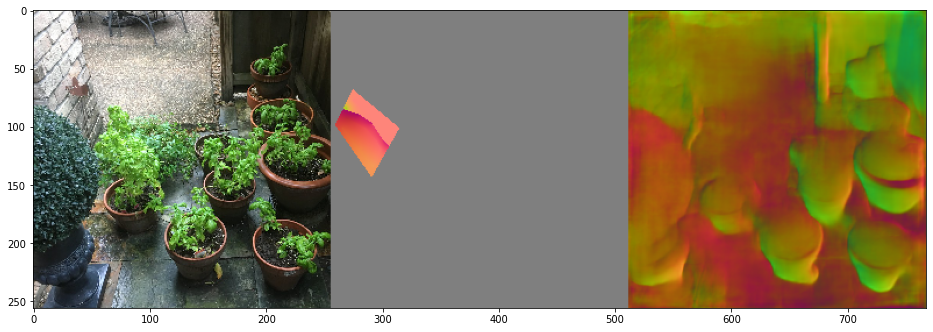

0.9999998 -0.9392989
1.0 0.0


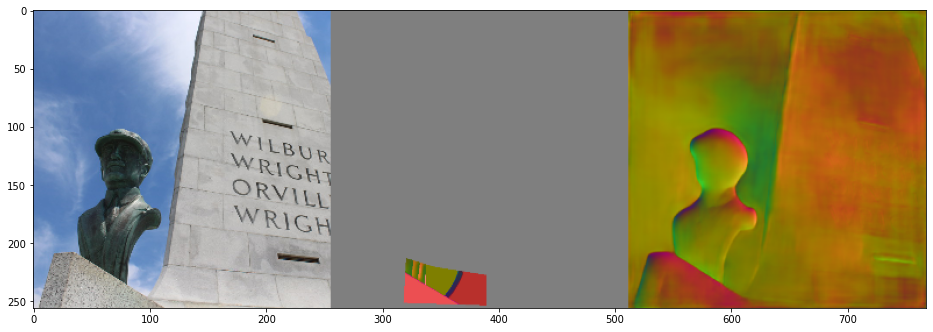

0.99999994 -0.9908572
1.0 0.0


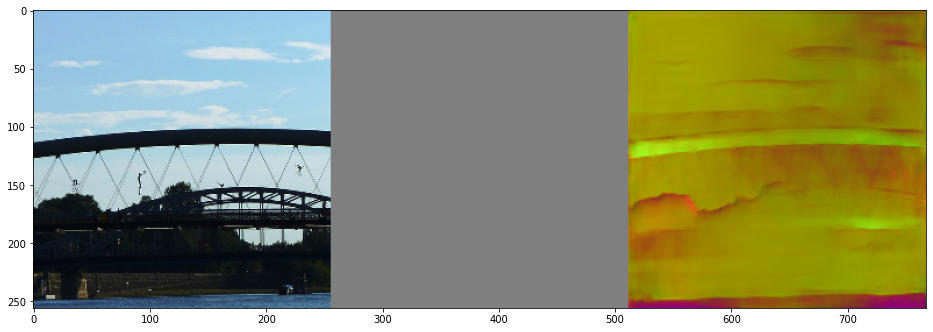

0.99998724 -0.9316617
1.0 0.0


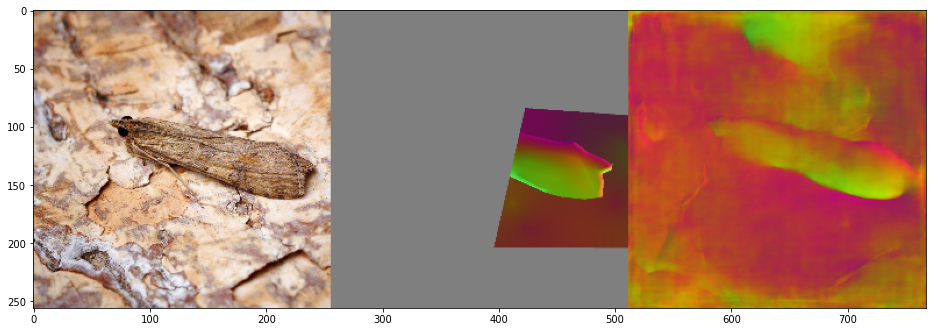

0.9999997 -0.9554906
1.0 0.0


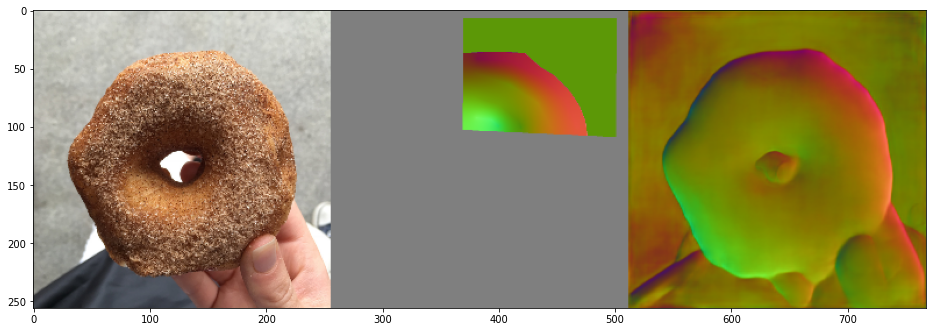

0.99999607 -0.990751
1.0 0.0


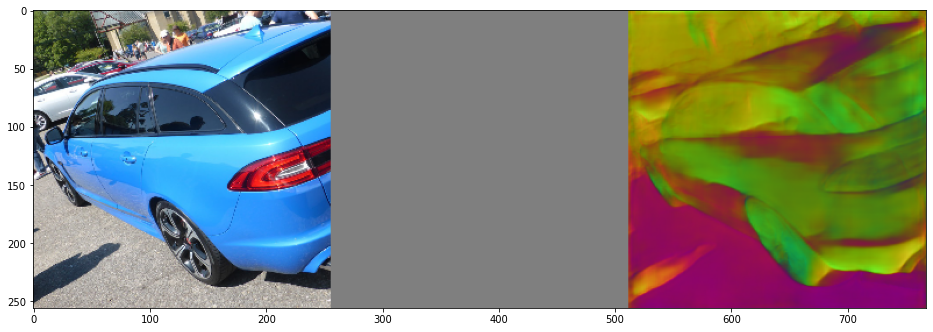

0.9999993 -0.910229
1.0 0.0


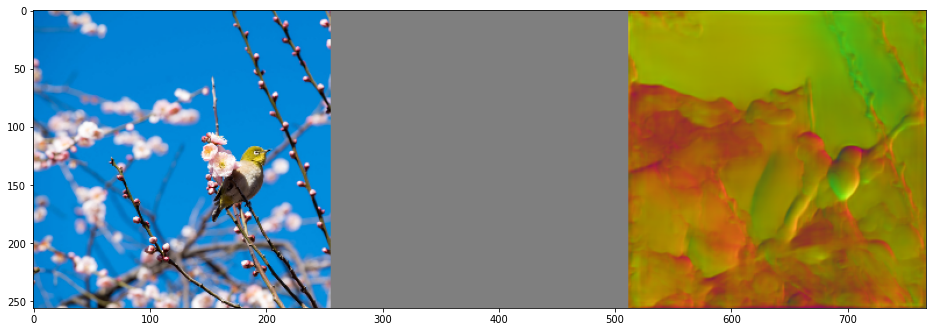

1.0 -0.93107164
1.0 0.0


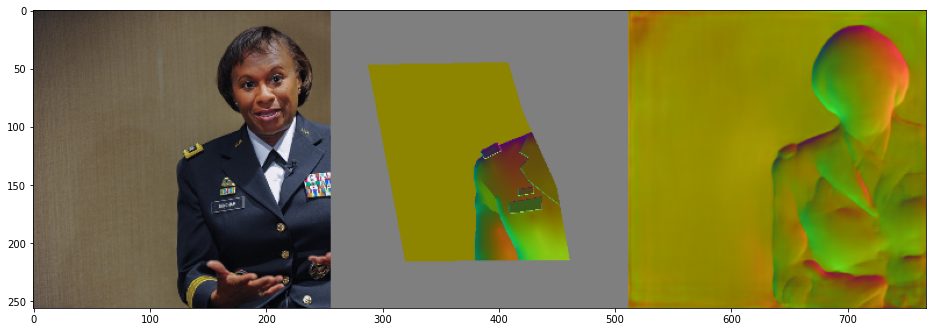

0.99999815 -0.9933972
1.0 0.0


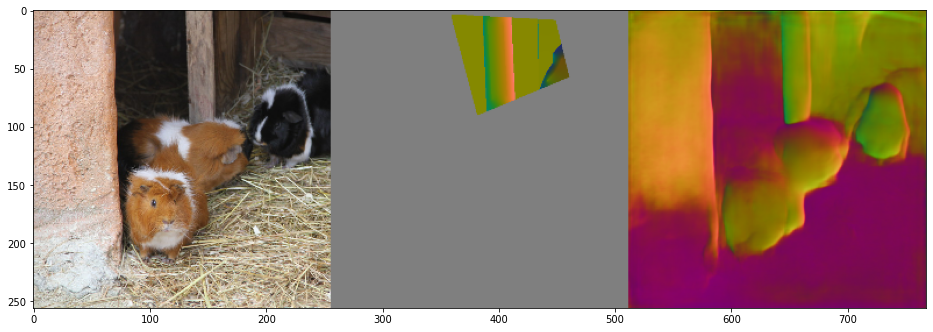

0.9999994 -0.9495521
1.0 0.0


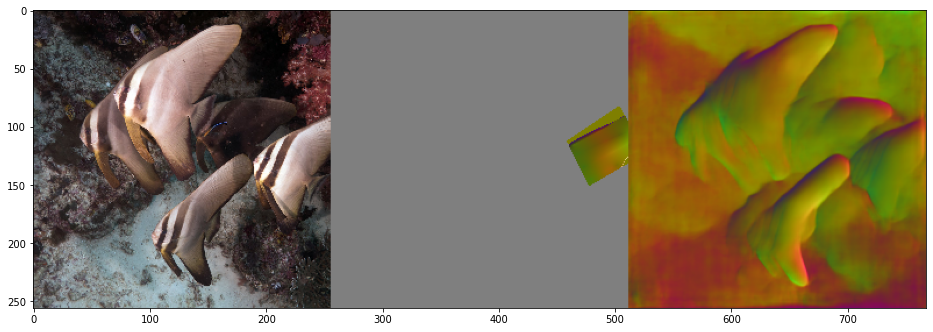

0.99999976 -0.9836778
1.0 0.0


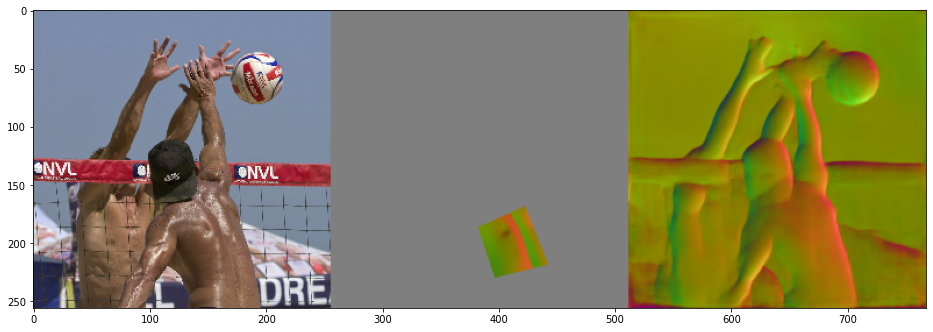

0.99999255 -0.7661014
1.0 0.0


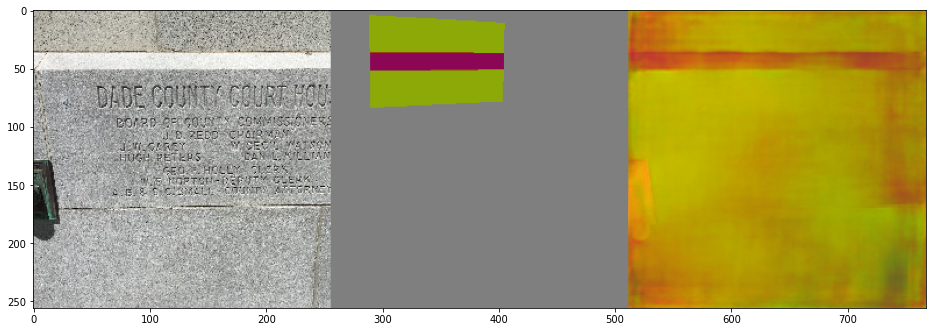

0.99999964 -0.99862874
1.0 0.0


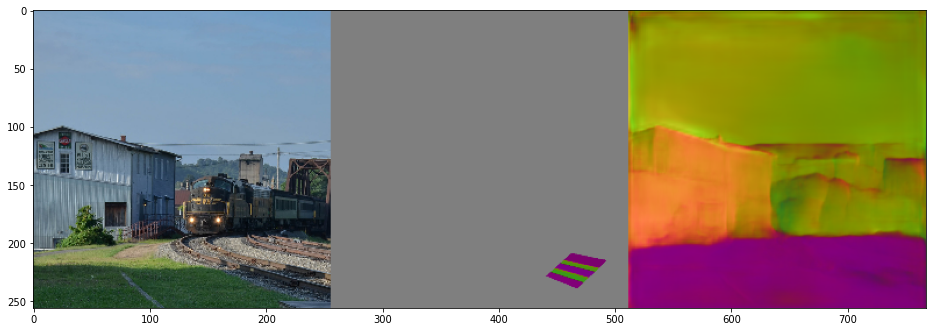

In [14]:
model.eval()
i = 0
with torch.no_grad():
    for step, data_tuple in enumerate(test_data_loader):
        
        if len(data_tuple) == 3:
            inputs, targets, target_res = data_tuple
        elif len(data_tuple) == 5:
            inputs, targets, masks, target_res, _ = data_tuple
            masks = masks.to(device)
            
        orig_height = target_res[0]
        orig_width = target_res[1]

        input_var = Variable(inputs.to(device))
        output_var = model(input_var)
        output_var = output_var / torch.linalg.norm(output_var, dim=1)
        targets = targets.to(device)
        
        ##### my code

        
        targets[:,2,:,:] *= -1
        targets = (targets + 1) / 2
        ############
        
        if step % 10 == 0:
            i += 1
            color = input_var[0,:,:,:].cpu().detach().numpy().transpose(1, 2, 0)
            pred = output_var[0,:,:,:].cpu().detach().numpy().transpose(1, 2, 0)
#             pred = pred / np.linalg.norm(pred, axis=2)
            
            gt = targets[0,:,:,:].cpu().detach().numpy().transpose(1, 2, 0)
            color = cv2.resize(color, (256, 256))
            gt = cv2.resize(gt, (256, 256))
            
            vis_normal(color, pred, gt)
        if i == 50: break

# My dataloader

In [17]:
oasis_root = '/scratch/ainaz/OASIS/OASIS_trainval/image'
oasis_dataloader = OASISDataset(root=oasis_root, output_size=256, normalized=False)
testset = oasis_dataloader.imgs
my_dataloader = DataLoader(
                oasis_dataloader, batch_size=1, shuffle=False,
                num_workers=64, pin_memory=False
            )

0
Found 10000 images in <class 'type'> folder.


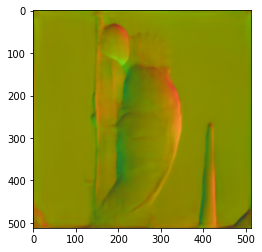

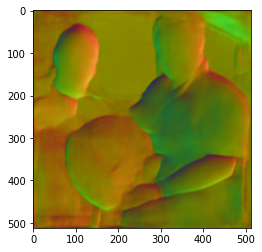

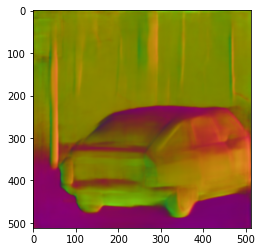

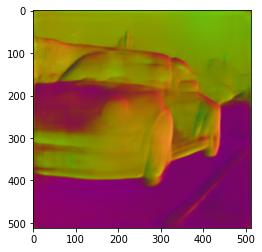

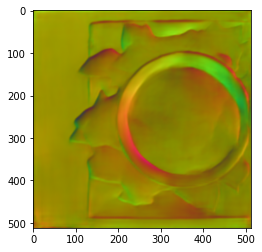

...

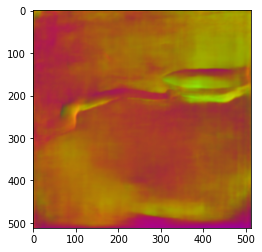

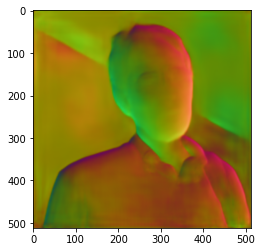

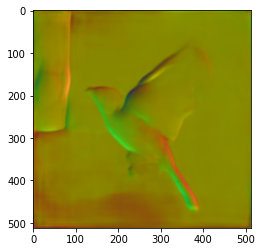

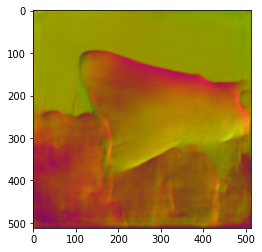

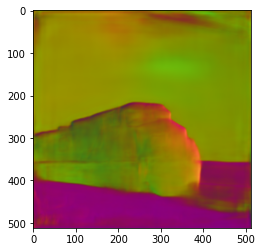

://


In [25]:
model.eval()
with torch.no_grad():
    for step, batch in enumerate(my_dataloader):
        rgb, normal_gt, mask_valid = batch
        rgb = rgb.cuda()
    
        output_var = model(rgb)
        output_var = output_var / torch.linalg.norm(output_var, dim=1)
          
        
        if step % 4 == 0:
            pred = output_var[0,:,:,:].cpu().detach().numpy().transpose(1, 2, 0)
            pred[:,:,2] *= -1
            pred -= np.min(pred)
            pred = pred * 1.0 / np.max(pred) 
            pred = cv2.resize(pred, (512, 512))
            pred = np.uint8(pred * 255.0)
            if step % 500 == 0:
                plt.imshow(pred)
                plt.show()
            im = Image.fromarray(pred)
            im.save(os.path.join('test_images', 'normal', 'oasis', f'{step}_pretrained_SNOW-size_256_pred.png'))


## Taskonomy

In [413]:
# dataset_path = '/datasets/evaluation_ood/real_world/images'
dataset_path = '/datasets/gc_chaostheory/ood_standard_set'
img_name = 'photo0.png'
path = os.path.join(dataset_path, img_name)
dataset = 'ood'

In [487]:
# dataset_path = '/scratch/ainaz/Onaga/rgb'
dataset_path = '/datasets/taskonomydata/collierville_rgb/rgb'
img_name = 'point_3_view_1_domain_rgb.png'
path = os.path.join(dataset_path, img_name)
dataset = 'taskonomy'

In [202]:
dataset_path = '/scratch/ainaz/replica-google-objects/apartment_0/6/rgb'
img_name = 'point_363_view_26_domain_rgb.png'
path = os.path.join(dataset_path, img_name)
dataset = 'gso'
img_name = 'frl5_15_point_363_view_26_domain_rgb.png'

torch.Size([1, 3, 256, 256])


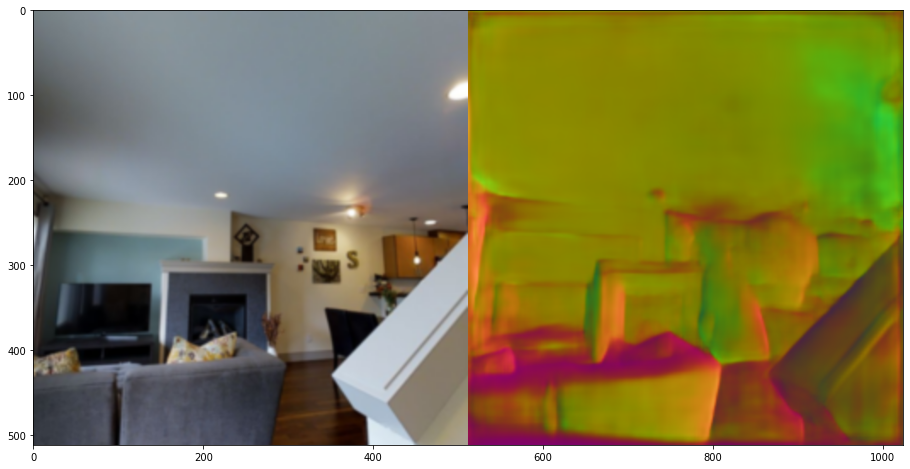

In [488]:
rgb = Image.open(path)
# rgb_np = np.array(rgb)
# rgb_np = cv2.resize(rgb_np, (512, 512))


transform = transforms.Compose([
    transforms.Resize(256, Image.BILINEAR), 
    transforms.CenterCrop(256),
    transforms.ToTensor()])

# rgb = transforms.ToTensor()(rgb).cuda()
rgb = transform(rgb).cuda()[:3,:,:]

print(rgb.unsqueeze(0).shape)
out = model(rgb.unsqueeze(0))
output_var = out / torch.linalg.norm(out, dim=1)

rgb_np = rgb.clone().cpu().detach().numpy().transpose(1, 2, 0)
rgb_np = cv2.resize(rgb_np, (512, 512))
rgb_np = np.uint8(rgb_np * 255)

          
pred = output_var[0,:,:,:].cpu().detach().numpy().transpose(1, 2, 0)
pred[:,:,2] *= -1
pred -= np.min(pred)
pred = pred * 1.0 / np.max(pred) 
pred = cv2.resize(pred, (512, 512))
pred = np.uint8(pred * 255.0)

plt.figure(figsize=(16, 8))
plt.imshow(np.concatenate([rgb_np, pred], axis=1))
plt.show()

im = Image.fromarray(pred)
im.save(f'/scratch/ainaz/omnidata2/normal_figure/{dataset}/{img_name[:-7]}_snow.png')
pred1 = pred

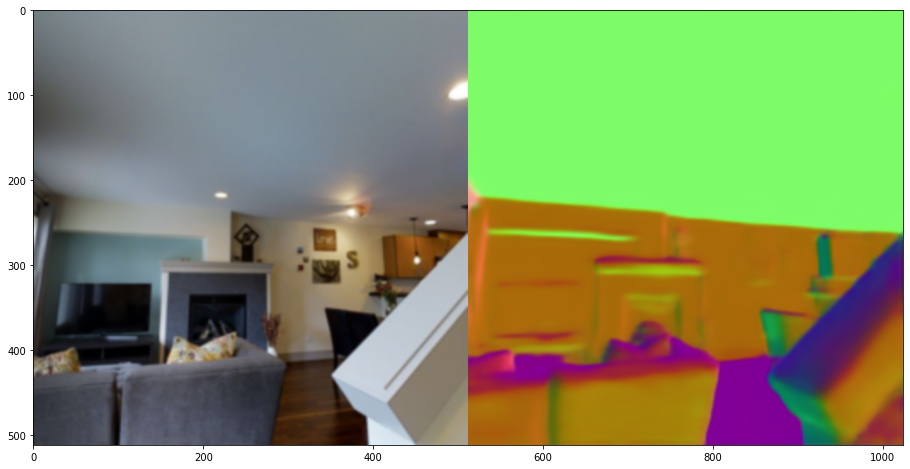

In [489]:
rgb = Image.open(path)
# rgb_np = np.array(rgb)
# rgb_np = cv2.resize(rgb_np, (512, 512))

transform = transforms.Compose([
    transforms.Resize(256, Image.BILINEAR), 
    transforms.CenterCrop(256),
    transforms.ToTensor()])
# rgb = transforms.ToTensor()(rgb).cuda()

rgb = transform(rgb).cuda()[:3,:,:]
out = unet(rgb.unsqueeze(0))
out = torch.clamp(out, 0, 1)
output_var = out
# output_var = out / torch.linalg.norm(out, dim=1)

rgb_np = rgb.clone().cpu().detach().numpy().transpose(1, 2, 0)
rgb_np = cv2.resize(rgb_np, (512, 512))
rgb_np = np.uint8(rgb_np * 255)
          
        
pred = output_var[0,:,:,:].cpu().detach().numpy().transpose(1, 2, 0)

pred = cv2.resize(pred, (512, 512))
pred = np.uint8(pred * 255.0)

plt.figure(figsize=(16, 8))
plt.imshow(np.concatenate([rgb_np, pred], axis=1))
plt.show()

im = Image.fromarray(pred)
im.save(f'/scratch/ainaz/omnidata2/normal_figure/{dataset}/{img_name[:-7]}_full.png')
pred2 = pred

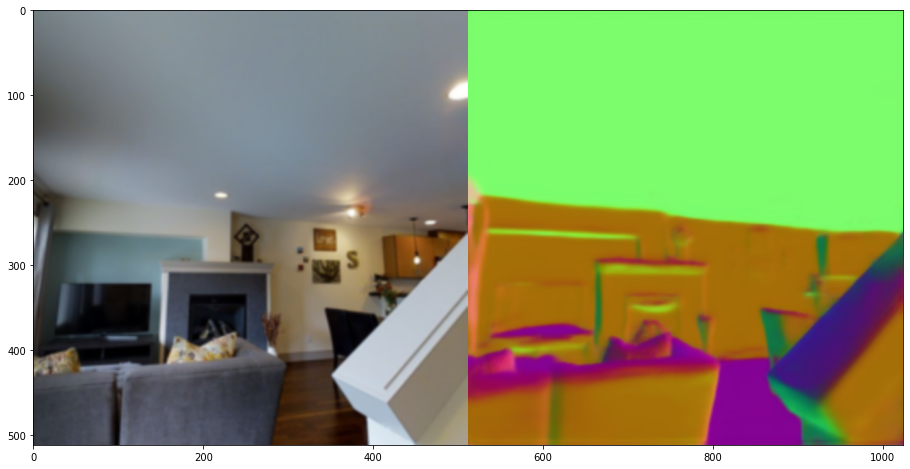

In [490]:
rgb = Image.open(path)
# rgb_np = np.array(rgb)
# rgb_np = cv2.resize(rgb_np, (512, 512))

transform = transforms.Compose([
    transforms.Resize(256, Image.BILINEAR), 
    transforms.CenterCrop(256),
    transforms.ToTensor()])
# rgb = transforms.ToTensor()(rgb).cuda()

rgb = transform(rgb).cuda()[:3,:,:]

out = unet2(rgb.unsqueeze(0))
out = torch.clamp(out, 0, 1)
output_var = out
# output_var = out / torch.linalg.norm(out, dim=1)
          
rgb_np = rgb.clone().cpu().detach().numpy().transpose(1, 2, 0)
rgb_np = cv2.resize(rgb_np, (512, 512))
rgb_np = np.uint8(rgb_np * 255)    

        
pred = output_var[0,:,:,:].cpu().detach().numpy().transpose(1, 2, 0)

pred = cv2.resize(pred, (512, 512))
pred = np.uint8(pred * 255.0)

plt.figure(figsize=(16, 8))
plt.imshow(np.concatenate([rgb_np, pred], axis=1))
plt.show()


im = Image.fromarray(pred)
im.save(f'/scratch/ainaz/omnidata2/normal_figure/{dataset}/{img_name[:-7]}_combined.png')
pred3 = pred

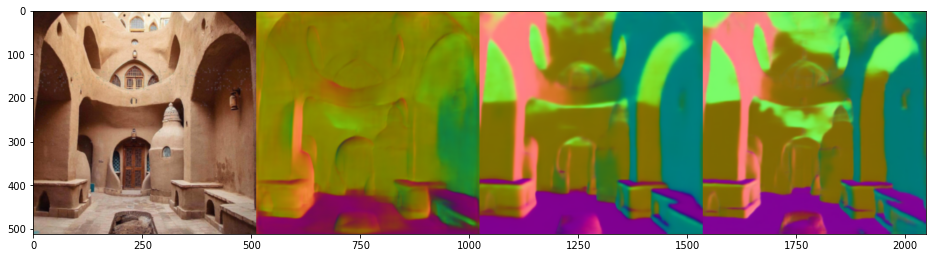

In [185]:
plt.figure(figsize=(16, 8))

im = np.concatenate([rgb_np, pred1, pred2, pred3], axis=1)
plt.imshow(im)

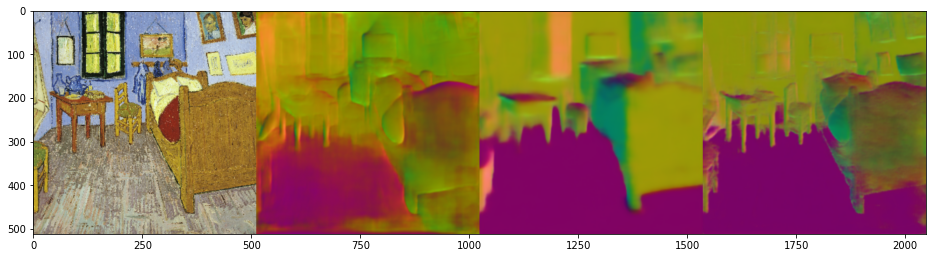

In [190]:
plt.figure(figsize=(16, 8))

im = np.concatenate([rgb_np, pred1, pred2, pred3], axis=1)
plt.imshow(im)

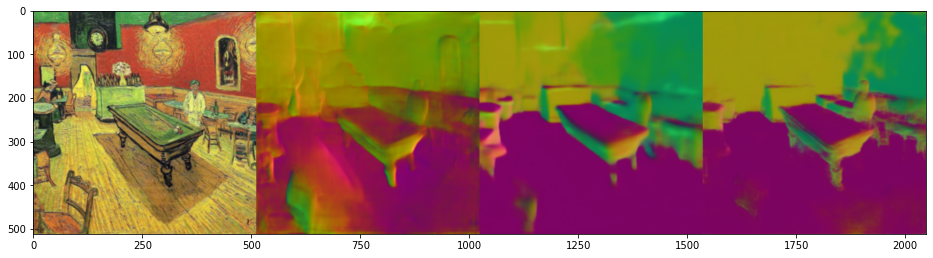

In [195]:
plt.figure(figsize=(16, 8))

im = np.concatenate([rgb_np, pred1, pred2, pred3], axis=1)
plt.imshow(im)

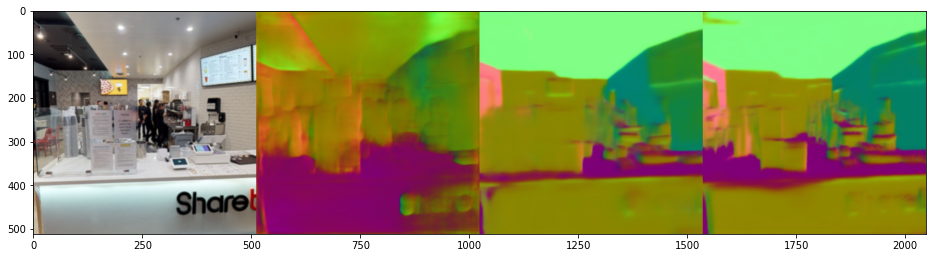

In [200]:
plt.figure(figsize=(16, 8))

im = np.concatenate([rgb_np, pred1, pred2, pred3], axis=1)
plt.imshow(im)

In [415]:
im = Image.fromarray(rgb_np)
im.save(f'/scratch/ainaz/omnidata2/normal_figure/{dataset}/{img_name}')